# Based on 50 traders price change thresholded w/ cash/value variable and table
Use similar clustering and video creation

In [42]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from library import utils, config
from library.utils import cosineSimP, cosineSimP_cash
import pickle

In [111]:
Ttransactions = pd.read_csv("./results/50_traders_change_price/w_valuetable/Ttransactions_50p_100s_wvtpricechange_thresholded.csv")
TstockChars = pd.read_csv("./results/50_traders_change_price/w_valuetable/TstockCharacteristics_wvtpricechange_thresholded.csv")
TstockPool = np.loadtxt("./results/50_traders_change_price/w_valuetable/TstockPool_100s_wvtpricechange_thresholded.txt")
ThurstPool = np.loadtxt("./results/50_traders_change_price/w_valuetable/ThurstPool_100s_wvtpricechange_thresholded.txt")
with open('./results/50_traders_change_price/w_valuetable/' + 'traderIDs_50_vt_pricechange_thresholded' + '.pkl', 'rb') as f:
    traderIDswvt = pickle.load(f)



In [151]:
def cosineSimP_cash2(time, portf1, portf2): #change from .stocks array to the weightdata arrays from objects
    """
    takes two portfolio objects and finds overlap between them including cash assets

    """
    overlapWeights = 0
    ptime1 = portf1.weightdata[portf1.weightdata['time']==time]
    ptime2 = portf2.weightdata[portf2.weightdata['time']==time]
    pcash1 = portf1.valuedata[portf1.valuedata['time']==time].cash[0]
    pcash2 = portf2.valuedata[portf2.valuedata['time']==time].cash[0]
#     print(portf1.valuedata[portf1.valuedata['time']==time])
#     print(pcash1)
    for i in portf1.stocks:
        if i in portf2.weights: # find the weights in portf1 and portf2
            pweight1 = int(ptime1[ptime1['stock']==i].weight)
            pweight2 = int(ptime2[ptime2['stock']==i].weight)
            overlapWeights += (pweight1 * pweight2) # actual weight calculation
    overlapWeights += pcash1*pcash2
    
    portf1weights = np.append(ptime1.weight.values,pcash1)
    portf2weights = np.append(ptime2.weight.values,pcash2)
#     print(ptime1)
#     print(portf1weights)
    
    portf1Norm = np.linalg.norm(portf1weights)
    portf2Norm = np.linalg.norm(portf2weights)
#     print(overlapWeights)
#     print(portf1Norm, portf2Norm, portf1Norm*portf2Norm)
    if portf1.portfID == portf2.portfID:
        assert round(overlapWeights/(portf1Norm*portf2Norm)) == 1
    
    return overlapWeights/(portf1Norm*portf2Norm)

In [ ]:
mat = np.zeros((50,50))
cosins = {}
for t in range(992,2200):
    mat2 = np.zeros((50,50))
    x = 0
    y = 0
    for i, portf1 in traderIDswvt.items():
        y=0
        for j, portf2 in traderIDswvt.items():
            csmp = cosineSimP_cash2(t,portf1,portf2)
            mat2[x,y] = csmp
            y += 1
        x += 1
    mat = np.dstack((mat,mat2))
    cosins[str(t)] = np.mean(mat2)
    print(np.mean(mat2))
    print(t)
    
mat = mat[:,:,1:]
print(np.shape(mat))

0.9736353539538525
992
0.980968308762461
993
0.9849361447794548
994
0.9877773968412868
995
0.9781413131131379
996
0.862889752371633
997
0.899996681881498
998
0.8463067751060241
999
0.7808038561420452
1000
0.8092422373100794
1001
0.8152925974219732
1002
0.8001038174926705
1003
0.8902752892757774
1004
0.8763243175014118
1005
0.8331660896628866
1006
0.8135215464162392
1007
0.8278271038836883
1008
0.7422018361632139
1009
0.6164956877660001
1010
0.6178527870051874
1011
0.5689263379763281
1012
0.633891805285939
1013
0.62281634676724
1014
0.7475632439320707
1015
0.7561580361714305
1016
0.7890996344648068
1017
0.715369514289268
1018
0.7253339941118713
1019
0.7953022949539917
1020
0.9128893789557148
1021
0.8456488969002414
1022
0.9371084633278081
1023
0.8795326545202276
1024
0.8148752943442527
1025
0.8788442848885046
1026
0.8431806136683252
1027
0.8514493855117151
1028
0.8463158636889057
1029
0.8027900173432218
1030
0.748671251289477
1031
0.7345647507369129
1032
0.8170148666459842
1033
0.908036

0.7921329810899534
1336
0.7901479968510359
1337
0.7895325920183477
1338
0.8129566612251269
1339
0.8113094304961984
1340
0.8112630149168887
1341
0.7906229401291992
1342
0.8122731662912861
1343
0.8123158718270684
1344
0.8116473604331315
1345
0.8147291348786142
1346
0.8143101107646975
1347
0.8142912106627771
1348
0.8580668932401272
1349
0.7917519414492544
1350
0.8605960373407648
1351
0.8691267060877254
1352
0.8674501926571077
1353
0.8689190719065837
1354
0.8649091926670411
1355
0.8652109756475113
1356
0.8688510874384218
1357
0.8658046366241949
1358
0.8663237654495218
1359
0.8412456814148158
1360
0.8393144393114373
1361
0.8410458451337494
1362
0.8708703978150832
1363
0.8694067866326691
1364
0.8311674288877678
1365
0.8641822623814732
1366
0.7999698484483837
1367
0.6963834977367117
1368
0.7411585453956566
1369
0.7562522755994608
1370
0.807174672704501
1371
0.8109411615624933
1372
0.8075284806939709
1373
0.803016638829616
1374
0.8086393457310392
1375
0.8086234310823771
1376
0.8085922230790449

0.6384022939555952
1680
0.6918506293555412
1681
0.6927265850037767
1682
0.6921542290254156
1683
0.6920248021456039
1684
0.6918714554496947
1685
0.6918667069231935
1686
0.6917413357890448
1687
0.6610623728623697
1688
0.7549326464236912
1689
0.7576253920412349
1690
0.7606471647654865
1691
0.760575010986526
1692
0.759403125219084
1693
0.7585705332384661
1694
0.7969522178136912
1695
0.7987537367740188
1696
0.7612800729269724
1697
0.7901556449007892
1698
0.7821697193530194
1699
0.7807163129965325
1700
0.847356237843373
1701
0.8408231306801394
1702
0.8311992044279126
1703
0.8367925524643575
1704
0.8468070416434904
1705
0.831905040064489
1706
0.7595776591113258
1707
0.7589855208658747
1708
0.7589876919502258
1709
0.7660314789943088
1710
0.769177646845071
1711
0.7023743722788774
1712
0.7013513509370648
1713
0.7013494613201591
1714
0.6932503379417032
1715
0.7017869245857812
1716
0.7697476867088531
1717
0.7073024537351658
1718
0.7702054131404461
1719
0.7703281729299961
1720
0.7734148527745528
17

(50, 50, 1008)


# Clustering

In [20]:
import hdbscan

clusterer = hdbscan.HDBSCAN()

clusterer.fit(mat[:,:,0])


HDBSCAN()

In [21]:
sortIndices = np.argsort(clusterer.labels_)
print(sortIndices)
# print(np.take_along_axis(clusterer.labels_,sortIndices, axis =0))

[49 15 12 11 48 30 19  8  5 43 31 18 39 40 41 42 21 20  0  1  2 16  3  6
 35 17 33 32  7 34 23 45 44 13 22  4 24 10 25 26 27 46 47  9 37 38 29 14
 28 36]


In [22]:
cosins

{'991': 0.14245925718343747,
 '992': 0.14250349450590657,
 '993': 0.14232453878150728,
 '994': 0.14220725030299972,
 '995': 0.1418698856294251,
 '996': 0.1414166952333344,
 '997': 0.14127854778653517,
 '998': 0.14091274582389895,
 '999': 0.14098076333907206,
 '1000': 0.141160117735513,
 '1001': 0.14103095898961845,
 '1002': 0.1405300264055333,
 '1003': 0.14045961972917734,
 '1004': 0.13990969017778057,
 '1005': 0.1396016894026945,
 '1006': 0.13947850617360377,
 '1007': 0.13936500694687662,
 '1008': 0.13914276874894294,
 '1009': 0.13982425005954638,
 '1010': 0.14002814190152088,
 '1011': 0.14032192216496797,
 '1012': 0.14065819202687913,
 '1013': 0.14097398841505895,
 '1014': 0.14095400405868175,
 '1015': 0.14073841725002662,
 '1016': 0.14034480311393469,
 '1017': 0.1398949731846181,
 '1018': 0.139917255328174,
 '1019': 0.139689034280413,
 '1020': 0.13938114308136543,
 '1021': 0.13916092973975389,
 '1022': 0.1390551406836251,
 '1023': 0.13902959332045967,
 '1024': 0.13914034888025112,
 

/home/braedyn/anaconda3/envs/mat36/lib/python3.6/site-packages/ipykernel_launcher.py:2: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  


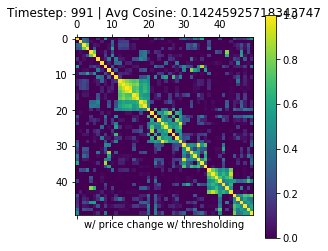

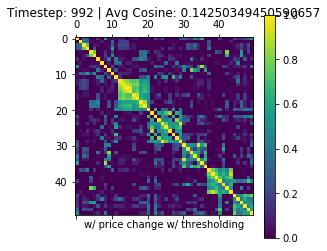

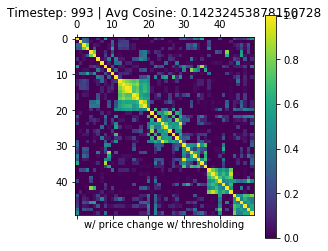

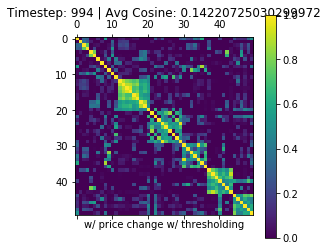

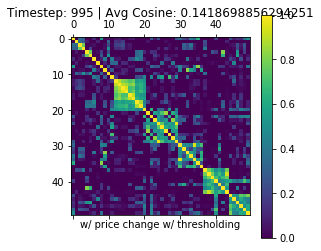

...

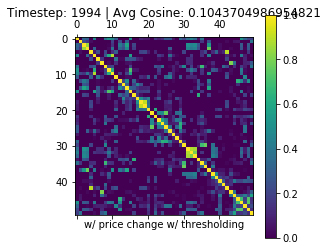

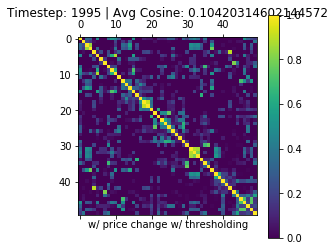

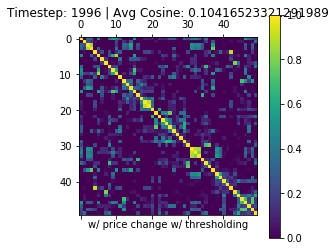

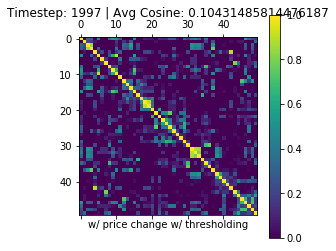

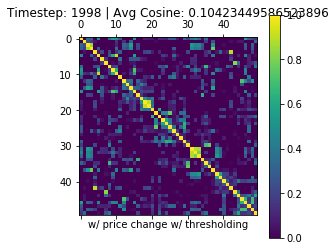

In [23]:
for i,t in enumerate(range(991,1999)):
    plt.matshow(mat[[sortIndices]][:,sortIndices,i]) # from HDBSCAN np.argsort or use np.ix_ 
    plt.title("Timestep: "+ str(t)+" | Avg Cosine: "+str(cosins[str(t)]), y=1.08)
    plt.xlabel("w/ price change w/ thresholding")
    plt.colorbar()
    plt.savefig('./results/50_traders_change_price/'+str(t).zfill(6)+'tmp.png', dpi=300)
    plt.show()

In [ ]:
# mencoder 'mf://*tmp.png' -mf type=png:fps=4 -ovc lavc -lavcopts vcodec=wmv2 -oac copy -o ./cosinesim_5950_points_50_pricechange_thresholding.mpg

# Looking at transactions list

In [2]:
# Ttransactions = pd.read_csv("./results/50_traders_change_price/Ttransactions_50p_100s_pricechange_thresholded.csv")
# TstockChars = pd.read_csv("./results/50_traders_change_price/TstockCharacteristics_pricechange_thresholded.csv")
# TstockPool = pd.read_csv("./results/50_traders_change_price/TstockPool_100s_pricechange_thresholded.txt")
# ThurstPool = pd.read_csv("./results/50_traders_change_price/ThurstPool_100s_pricechange_thresholded.txt")

In [10]:
totalCascades = np.asarray([])
for s in range(100):
    stockTrans = Ttransactions[Ttransactions['stock']==s]
    if len(stockTrans) > 0:
#         stockTrans.hist(column='ToS', bins=np.arange(992,2000))
#         plt.title("Transactions of stock: "+ str(s))
#         plt.show()
        cascades = findStockCascades(stockTrans, maxSep = 2)
#         print(len(cascades))
        totalCascades = np.append(totalCascades,cascades)

In [17]:
hist, bins = np.histogram(totalCascades, bins=np.logspace(np.log10(1),np.log10(3000),25))
binsize = np.diff(bins)

mid = np.array([])
for i in range(len(binsize)):
    avg = (bins[i]+bins[i+1])/2
    mid = np.append(mid,avg)

24
25
24
[1.19799138e+00 1.67237530e+00 2.33460707e+00 3.25907120e+00
 4.54960718e+00 6.35117315e+00 8.86612817e+00 1.23769620e+01
 1.72780255e+01 2.41198255e+01 3.36708604e+01 4.70039404e+01
 6.56166900e+01 9.15997675e+01 1.27871695e+02 1.78506681e+02
 2.49192248e+02 3.47868080e+02 4.85617840e+02 6.77914128e+02
 9.46356430e+02 1.32109725e+03 1.84422898e+03 2.57451184e+03]


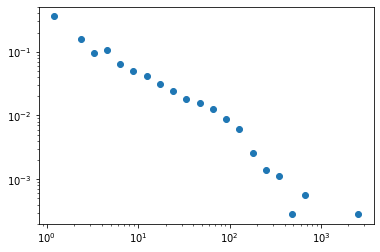

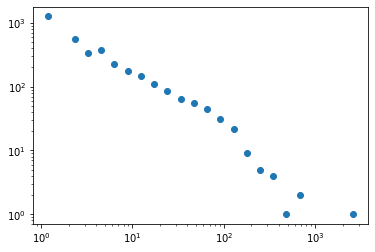

In [37]:
plt.plot(mid,hist,'o')
plt.loglog()
plt.show()

In [106]:
print(((stockTrans.ToS.unique())))
print(np.diff(stockTrans.ToS.unique()))
keys = (np.where(np.diff(stockTrans.ToS.unique())>10))

[1665 1671 1675 1688 1689 1692 1695 1701 1705 1706 1709 1711 1712 1713
 1715 1716 1723 1724 1726 1728 1729 1730 1731 1734 1738 1746 1753 1757
 1758 1760 1762 1764 1766 1768 1772 1773 1775 1776 1777 1778 1780 1781
 1782 1786 1788 1789 1792 1793 1794 1797 1799 1800 1813 1819 1824 1825
 1827 1828 1830 1832 1834 1838 1842 1844 1845 1849 1851 1855 1857 1860
 1863 1866 1869 1870 1874 1875 1876 1891 1896 1898 1901 1903 1911 1913
 1915 1926 1933 1936 1946 1956 1960 1965 1967 1972 1978 1984 1985 1986
 1997]
[ 6  4 13  1  3  3  6  4  1  3  2  1  1  2  1  7  1  2  2  1  1  1  3  4
  8  7  4  1  2  2  2  2  2  4  1  2  1  1  1  2  1  1  4  2  1  3  1  1
  3  2  1 13  6  5  1  2  1  2  2  2  4  4  2  1  4  2  4  2  3  3  3  3
  1  4  1  1 15  5  2  3  2  8  2  2 11  7  3 10 10  4  5  2  5  6  6  1
  1 11]


In [132]:
# stockTrans.ToS.unique()[np.where(np.diff(stockTrans.ToS.unique())>10)]
len([])

0

In [3]:
def findStockCascades(stockTrans, maxSep = 10):
    """
    works on transactions and stockTransactions tables
    """
    
    if len(stockTrans) > 0 :
        ToS = stockTrans.ToS.unique()
        sep = np.diff(ToS)
        keySep = np.where(sep>maxSep)[0]

        i0 = 0
        cascadeSizes = np.asarray([])
        for key in keySep:
            key += 1
    #         print(i0, key)
            times = ToS[i0:key]
            cascadeSize = len(stockTrans[stockTrans.ToS.isin(times)])
            cascadeSizes = np.append(cascadeSizes,cascadeSize)
            i0 = key

        return cascadeSizes
    else:
        return []

In [116]:
findStockCascades(stockTrans)

0 3
3 52
52 77
77 85
85 98


array([ 3., 49., 26.,  8., 13.])

In [120]:
print(stockTrans.ToS.unique())
print(stockTrans.ToS.unique()[0:3])
print(stockTrans.ToS.unique()[3:52])
print(stockTrans.ToS.unique()[52:77])
print(stockTrans.ToS.unique()[77:85])
print(stockTrans.ToS.unique()[85:98])

[1665 1671 1675 1688 1689 1692 1695 1701 1705 1706 1709 1711 1712 1713
 1715 1716 1723 1724 1726 1728 1729 1730 1731 1734 1738 1746 1753 1757
 1758 1760 1762 1764 1766 1768 1772 1773 1775 1776 1777 1778 1780 1781
 1782 1786 1788 1789 1792 1793 1794 1797 1799 1800 1813 1819 1824 1825
 1827 1828 1830 1832 1834 1838 1842 1844 1845 1849 1851 1855 1857 1860
 1863 1866 1869 1870 1874 1875 1876 1891 1896 1898 1901 1903 1911 1913
 1915 1926 1933 1936 1946 1956 1960 1965 1967 1972 1978 1984 1985 1986
 1997]
[1665 1671 1675]
[1688 1689 1692 1695 1701 1705 1706 1709 1711 1712 1713 1715 1716 1723
 1724 1726 1728 1729 1730 1731 1734 1738 1746 1753 1757 1758 1760 1762
 1764 1766 1768 1772 1773 1775 1776 1777 1778 1780 1781 1782 1786 1788
 1789 1792 1793 1794 1797 1799 1800]
[1813 1819 1824 1825 1827 1828 1830 1832 1834 1838 1842 1844 1845 1849
 1851 1855 1857 1860 1863 1866 1869 1870 1874 1875 1876]
[1891 1896 1898 1901 1903 1911 1913 1915]
[1926 1933 1936 1946 1956 1960 1965 1967 1972 1978 1984 198

# Var vs alloc

In [130]:
# for i, portf in traderIDswvt.items():
# #     print(len(portf.valuedata.time.unique()))
# #     print(len(portf.weightdata.time.unique()))  
#     print(portf.portfID)
# #     plt.plot(portf.valuedata.time.values,portf.valuedata.value.values)
# #     plt.show()

portf = traderIDswvt['okcps']


In [131]:
# print(TstockChars)
# print(portf.valuedata[portf.valuedata.time==992].value[0])
print(portf.weightdata)

       ID  time  stock  weight
0   okcps   991     60     0.0
0   okcps   991     10    70.0
0   okcps   991     51     0.0
0   okcps   991     97    38.0
0   okcps   991     90     0.0
..    ...   ...    ...     ...
0   okcps  2198     98    21.0
0   okcps  2198     70     0.0
0   okcps  2198     46     0.0
0   okcps  2198     81     6.0
0   okcps  2198     63     0.0

[18120 rows x 4 columns]


In [ ]:
def weightvarMovie(portf,TstockChars,TstockPool):
    ovar = np.array([])
    oalloc = np.array([])
    ocashalloc = 0
    times = portf.valuedata.time.unique()
    
    for t in times[1::10]:
        alloc = np.array([])
        var = np.array([])
        stocks = portf.stocks
        maxvar = max(TstockChars[TstockChars.stock.isin(stocks)]['var'])+0.5
        maxalloc = 1
        
        
        for s in stocks:
            weight = portf.weightdata[portf.weightdata.time==t]
            alloc = np.append(alloc, weight[weight.stock==s].weight[0]*TstockPool[s,t]/
                                 portf.valuedata[portf.valuedata.time==t].value[0])
            timeStockChars = TstockChars[TstockChars.time==t]
            var = np.append(var,timeStockChars[timeStockChars.stock==s]['var'])
            
        # include cash
        cashalloc = portf.valuedata[portf.valuedata.time==t].cash[0]/portf.valuedata[portf.valuedata.time==t].value[0]
        cashvar = 0
        
        plt.plot(cashvar, ocashalloc, color='lightgreen')
        plt.plot(cashvar, cashalloc, color='green', label='Cash')
        plt.plot(ovar,oalloc,'o', color = 'lightblue')
        plt.plot(var,alloc, 'o')
        plt.grid(True)
    #     plt.xlim(right=maxvar, left=0)
    #     plt.ylim(top=maxalloc,bottom=0)
        plt.xlabel("Stock Variance")
        plt.ylabel("Weight Allocation")
        plt.legend()
        plt.title("Portf ID: " + str(portf.portfID) +" | Time: "+ str(t))
        plt.savefig("./results/50_traders_change_price/w_valuetable/"+str(t).zfill(6)+'wv_tmp.png',dpi=250)
        plt.show()
        ovar = var
        oalloc = alloc 
        ocashalloc = cashalloc
    print("Done")
    print("mencoder 'mf://*wv_tmp.png' -mf type=png:fps=4 -ovc lavc -lavcopts vcodec=wmv2 -oac copy -o ./weightvar_"+portf.portfID+"_pricechange_thresholding.mpg")
        
weightvarMovie(portf,TstockChars,TstockPool)

In [120]:
# mencoder 'mf://*wv_tmp.png' -mf type=png:fps=4 -ovc lavc -lavcopts vcodec=wmv2 -oac copy -o ./weightvar_puokv_pricechange_thresholding.mpg

4.29818110778916

In [128]:
import subprocess